In [1]:
import torch
from diffusers import StableDiffusionPipeline
# from diffusers import StableDiffusionXLPipeline

device = "cuda"
# model_id = "/media/wtyang/KINGSTON/Model/stable-diffusion-v1-4"
model_id = "/media/wtyang/KINGSTON/Model/stable-diffusion-v1-5"

pipe = StableDiffusionPipeline.from_pretrained(
    model_id,
    revision="fp16",
    torch_dtype=torch.float16,
    use_auth_token=True,
).to(device)

#model_id = "/media/wtyang/KINGSTON/Model/stable-diffusion-xl-base-1.0"

Keyword arguments {'use_auth_token': True} are not expected by StableDiffusionPipeline and will be ignored.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

默认情况下，[DiffusionPipeline] 使用完整的 float32 精度进行 50 步推理。可以通过降低精度（如 float16 ）或者减少推理步数来加速整个过程

In [2]:
from PIL import Image

def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    # grid_w, grid_h = grid.size
    
    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

In [3]:
num_images = 4

width = 512
height = 512

In [4]:
generator = torch.Generator(device=device)

latents = None
seeds = []
for _ in range(num_images):
    # Get a new random seed, store it and use it as the generator state
    seed = generator.seed()
    seeds.append(seed)
    generator = generator.manual_seed(seed)
    
    image_latents = torch.randn(
        (1, pipe.unet.in_channels, height // 8, width // 8),
        generator = generator,
        device = device
    )
    latents = image_latents if latents is None else torch.cat((latents, image_latents))
    
print(seeds)
# latents shape (4, 4, 64, 64)
latents.shape

[1936519277681924, 4597301259302684, 3102816825215066, 759713435311670]


/tmp/ipykernel_294809/3458346778.py:12: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  (1, pipe.unet.in_channels, height // 8, width // 8),


torch.Size([4, 4, 64, 64])

  0%|          | 0/50 [00:00<?, ?it/s]

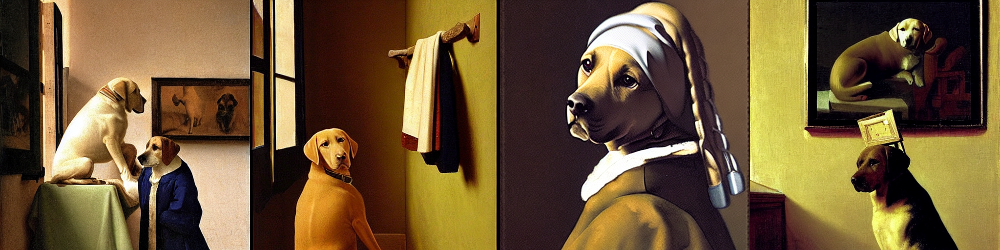

In [8]:
prompt = "Labrador in the style of Vermeer"
generator = [torch.Generator(device="cuda").manual_seed(i) for i in range(4)]
images = pipe(prompt, generator=generator, num_images_per_prompt=4).images
image_grid(images, 1, 4)

---

find which schedulers are compatible with the current model in the [DiffusionPipeline] by calling the compatibles method:

In [11]:
import diffusers.schedulers
pipe.scheduler.compatibles
[
    diffusers.schedulers.scheduling_lms_discrete.LMSDiscreteScheduler,
    diffusers.schedulers.scheduling_unipc_multistep.UniPCMultistepScheduler,
    diffusers.schedulers.scheduling_k_dpm_2_discrete.KDPM2DiscreteScheduler,
    diffusers.schedulers.scheduling_deis_multistep.DEISMultistepScheduler,
    diffusers.schedulers.scheduling_euler_discrete.EulerDiscreteScheduler,
    diffusers.schedulers.scheduling_dpmsolver_multistep.DPMSolverMultistepScheduler,
    diffusers.schedulers.scheduling_ddpm.DDPMScheduler,
    diffusers.schedulers.scheduling_dpmsolver_singlestep.DPMSolverSinglestepScheduler,
    diffusers.schedulers.scheduling_k_dpm_2_ancestral_discrete.KDPM2AncestralDiscreteScheduler,
    diffusers.utils.dummy_torch_and_torchsde_objects.DPMSolverSDEScheduler,
    diffusers.schedulers.scheduling_heun_discrete.HeunDiscreteScheduler,
    diffusers.schedulers.scheduling_pndm.PNDMScheduler,
    diffusers.schedulers.scheduling_euler_ancestral_discrete.EulerAncestralDiscreteScheduler,
    diffusers.schedulers.scheduling_ddim.DDIMScheduler,
]

[diffusers.schedulers.scheduling_lms_discrete.LMSDiscreteScheduler,
 diffusers.schedulers.scheduling_unipc_multistep.UniPCMultistepScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_discrete.KDPM2DiscreteScheduler,
 diffusers.schedulers.scheduling_deis_multistep.DEISMultistepScheduler,
 diffusers.schedulers.scheduling_euler_discrete.EulerDiscreteScheduler,
 diffusers.schedulers.scheduling_dpmsolver_multistep.DPMSolverMultistepScheduler,
 diffusers.schedulers.scheduling_ddpm.DDPMScheduler,
 diffusers.schedulers.scheduling_dpmsolver_singlestep.DPMSolverSinglestepScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_ancestral_discrete.KDPM2AncestralDiscreteScheduler,
 diffusers.utils.dummy_torch_and_torchsde_objects.DPMSolverSDEScheduler,
 diffusers.schedulers.scheduling_heun_discrete.HeunDiscreteScheduler,
 diffusers.schedulers.scheduling_pndm.PNDMScheduler,
 diffusers.schedulers.scheduling_euler_ancestral_discrete.EulerAncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_ddim.DDI

The Stable Diffusion model uses the [PNDMScheduler] by default which usually requires ~50 inference steps, but more performant schedulers like [DPMSolverMultistepScheduler], require only ~20 or 25 inference steps.

  0%|          | 0/20 [00:00<?, ?it/s]

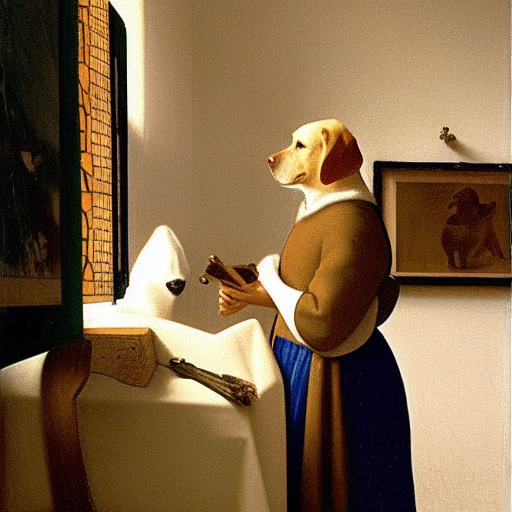

In [13]:
from diffusers import DPMSolverMultistepScheduler

pipe.scheduler = DPMSolverMultistepScheduler.from_config(pipe.scheduler.config)

generator = torch.Generator("cuda").manual_seed(0)
image = pipe(prompt, generator=generator, num_inference_steps=20).images[0]
image

In [14]:
def get_inputs(batch_size=1):
    generator = [torch.Generator("cuda").manual_seed(i) for i in range(batch_size)]
    prompts = batch_size * [prompt]
    num_inference_steps = 20

    return {"prompt": prompts, "generator": generator, "num_inference_steps": num_inference_steps}

  0%|          | 0/20 [00:00<?, ?it/s]

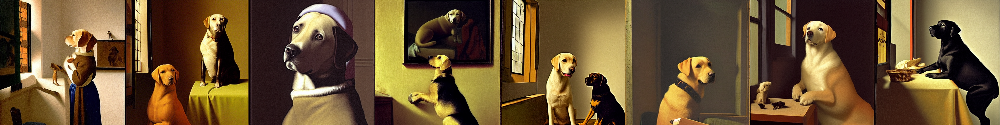

In [18]:
from diffusers.utils import make_image_grid

images = pipe(**get_inputs(batch_size=8)).images
make_image_grid(images, 1, 8)

batch 数较大时代码可能会返回错误OOM！大部分内存被交叉注意力层占用。可以按顺序运行该操作，而不是批量运行该操作，以节省大量内存。所要做的就是配置管道以使用 [ ~DiffusionPipeline.enable_attention_slicing] 函数：

  0%|          | 0/20 [00:00<?, ?it/s]

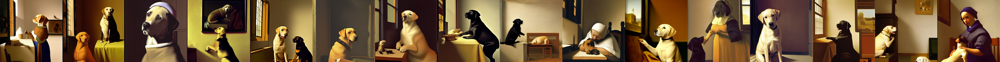

In [20]:
pipe.enable_attention_slicing()
images = pipe(**get_inputs(batch_size=16)).images
image_grid(images, rows=1, cols=16)

---

更好的 checkpoint，更好的管道组件

  0%|          | 0/20 [00:00<?, ?it/s]

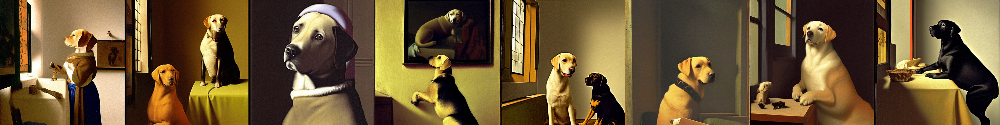

In [21]:
from diffusers import AutoencoderKL

vae = AutoencoderKL.from_pretrained("/media/wtyang/KINGSTON/Model/sd-vae-ft-mse", torch_dtype=torch.float16).to("cuda")
pipe.vae = vae
images = pipe(**get_inputs(batch_size=8)).images
image_grid(images, rows=1, cols=8)